In [54]:
!pip install git+https://github.com/facebookresearch/detectron2.git

  Cloning https://github.com/facebookresearch/detectron2.git to c:\users\shane\appdata\local\temp\pip-req-build-e80_pxlr
  Resolved https://github.com/facebookresearch/detectron2.git to commit cc9266c2396d5545315e3601027ba4bc28e8c95b
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
     ---------------------------------------- 0.0/50.2 kB ? eta -:--:--
     ------------------------ --------------- 30.7/50.2 kB 1.4 MB/s eta 0:00:01
     ---------------------------------------- 50.2/50.2 kB 1.3 MB/s eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
     ---------------------------------------- 0.0/76.0 kB ? eta -:--:--
     ---------------------------------------- 76.0/76.0 kB 4.4 MB/s eta 0:00:00
     ---------------------------------------- 0.0/117.0 kB ? eta -:--:--
     -------------------------------------- 117.0/117.0 kB 6.7 MB/s eta 0:00:00
  Preparing metadata (set

  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git 'C:\Users\shane\AppData\Local\Temp\pip-req-build-e80_pxlr'


In [8]:
import os
from PIL import Image

from src.model_a import ModelA

C:\Users\shane\anaconda3\envs\Python3-10-Build\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [23]:
data_cfg = 'yolo-data-conf.yaml'
base_model_name = 'yolov8s'
new_model_name = 'yolov8s_hat_glass'

device = 'cpu'
# m1/m2 training, for gpu: [0]
train_args = {
    # Options include SGD, Adam, AdamW, NAdam, RAdam, RMSProp etc., or auto
    "optimizer": 'AdamW',
    "learning_rate": 5e-4,
    "momentum": 0.938,
    "freeze": 8,  # the first N layers
    "batch": -1,
    "patience": 4,
    "epochs": 100,
    "model_name": new_model_name
}


In [24]:
# cmd tensorboard --logdir runs/train/ (default)
# "log_dir": 'runs/train/',
%load_ext tensorboard
%tensorboard --logdir runs/logs/yolov8s

# train model, baseline: v8n | v8s | v8m | v8m | v8x
model = ModelA(model=f'{base_model_name}.pt', data_cfg=data_cfg, device=device)
yolo, result = model.train(project_dir=os.path.join(os.getcwd(), 'data_models', 'my_trained_models', owner),
                            conf=train_args)

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 193376), started 0:07:15 ago. (Use '!kill 193376' to kill it.)

Ultralytics YOLOv8.1.30 🚀 Python-3.10.13 torch-2.2.1+cpu CPU (Intel Core(TM) i7-4790K 4.00GHz)
engine\trainer: task=detect, mode=train, model=data_models/pre_trained_models/yolov8s.pt, data=yolo-data-conf.yaml, epochs=100, time=None, patience=4, batch=-1, imgsz=640, save=True, save_period=-1, cache=False, device=cpu, workers=8, project=C:\Users\shane\object-detect-main\data_models\my_trained_models\j, name=yolov8s_hat_glass, exist_ok=True, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=8, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_fra

100%|██████████| 755k/755k [00:00<00:00, 9.19MB/s]


Overriding model.yaml nc=80 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics

train: Scanning C:\Users\shane\object-detect-main\data_models\labels\train... 164 images, 0 backgrounds, 0 corrupt: 100%|██████████| 164/164 [00:00<00:00, 334.16it/s]

train: New cache created: C:\Users\shane\object-detect-main\data_models\labels\train.cache



val: Scanning C:\Users\shane\object-detect-main\data_models\labels\val... 37 images, 0 backgrounds, 0 corrupt: 100%|██████████| 37/37 [00:00<00:00, 327.17it/s]

val: New cache created: C:\Users\shane\object-detect-main\data_models\labels\val.cache


Plotting labels to C:\Users\shane\object-detect-main\data_models\my_trained_models\j\yolov8s_hat_glass\labels.jpg... 
optimizer: AdamW(lr=0.0005, momentum=0.938) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to C:\Users\shane\object-detect-main\data_models\my_trained_models\j\yolov8s_hat_glass
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100         0G      1.659      2.553      1.411         28        640: 100%|██████████| 11/11 [02:33<00:00, 13.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:20<00:00, 10.16s/it]

                   all         37        123      0.689      0.214      0.138     0.0851



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100         0G       1.29      1.483      1.194         47        640: 100%|██████████| 11/11 [02:32<00:00, 13.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.49s/it]

                   all         37        123      0.519      0.552      0.504      0.305



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100         0G      1.263       1.33      1.159         50        640: 100%|██████████| 11/11 [02:36<00:00, 14.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:15<00:00,  7.88s/it]

                   all         37        123      0.731      0.516      0.629      0.405



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100         0G      1.156      1.133      1.098         31        640: 100%|██████████| 11/11 [02:32<00:00, 13.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:15<00:00,  7.63s/it]

                   all         37        123      0.641      0.669      0.726      0.436



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100         0G      1.086      1.041      1.063         24        640: 100%|██████████| 11/11 [02:36<00:00, 14.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:13<00:00,  6.90s/it]

                   all         37        123      0.716      0.669      0.781      0.464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100         0G      1.076     0.9571      1.074         36        640: 100%|██████████| 11/11 [02:18<00:00, 12.60s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:14<00:00,  7.49s/it]

                   all         37        123      0.717       0.71      0.812      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100         0G       1.11     0.9352      1.062         27        640: 100%|██████████| 11/11 [02:39<00:00, 14.49s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:14<00:00,  7.39s/it]

                   all         37        123      0.795      0.755      0.838      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100         0G      1.062     0.8834      1.056         28        640: 100%|██████████| 11/11 [03:30<00:00, 19.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:29<00:00, 14.68s/it]

                   all         37        123      0.806       0.77      0.836      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100         0G      1.014     0.8389      1.077         12        640: 100%|██████████| 11/11 [03:04<00:00, 16.78s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:15<00:00,  7.69s/it]

                   all         37        123      0.843       0.75      0.846      0.543



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100         0G      1.037     0.8105      1.047         15        640: 100%|██████████| 11/11 [02:45<00:00, 15.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.71s/it]

                   all         37        123      0.844      0.787      0.865      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100         0G      1.004       0.79      1.043         17        640: 100%|██████████| 11/11 [02:31<00:00, 13.76s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.76s/it]

                   all         37        123      0.853      0.724      0.868      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100         0G     0.9685     0.7635      1.005         12        640: 100%|██████████| 11/11 [02:22<00:00, 12.98s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:14<00:00,  7.12s/it]

                   all         37        123      0.878      0.722      0.866      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100         0G      1.018     0.7806      1.004         37        640: 100%|██████████| 11/11 [02:31<00:00, 13.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:14<00:00,  7.15s/it]

                   all         37        123      0.882      0.778      0.884      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100         0G     0.9971     0.7462      1.003         14        640: 100%|██████████| 11/11 [02:33<00:00, 13.96s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:14<00:00,  7.48s/it]

                   all         37        123       0.75      0.826      0.854      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100         0G     0.9842     0.7218          1         31        640: 100%|██████████| 11/11 [02:25<00:00, 13.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:14<00:00,  7.13s/it]

                   all         37        123      0.799      0.784      0.861       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100         0G     0.9626      0.706     0.9821         34        640: 100%|██████████| 11/11 [02:16<00:00, 12.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:13<00:00,  6.78s/it]

                   all         37        123      0.846      0.832      0.895      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100         0G     0.9746     0.6888     0.9802         48        640: 100%|██████████| 11/11 [02:13<00:00, 12.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:13<00:00,  6.60s/it]

                   all         37        123      0.824      0.808      0.874      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100         0G     0.9415     0.6907     0.9808         44        640: 100%|██████████| 11/11 [02:11<00:00, 11.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:13<00:00,  6.92s/it]

                   all         37        123      0.834      0.817       0.87      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100         0G     0.9436     0.6836     0.9666         50        640: 100%|██████████| 11/11 [02:20<00:00, 12.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:14<00:00,  7.10s/it]

                   all         37        123      0.767      0.835      0.869      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100         0G     0.9053     0.6615     0.9695         20        640: 100%|██████████| 11/11 [02:55<00:00, 15.98s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.09s/it]

                   all         37        123      0.858      0.804      0.891       0.58
Stopping training early as no improvement observed in last 4 epochs. Best results observed at epoch 16, best model saved as best.pt.
To update EarlyStopping(patience=4) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



20 epochs completed in 0.955 hours.
Optimizer stripped from C:\Users\shane\object-detect-main\data_models\my_trained_models\j\yolov8s_hat_glass\weights\last.pt, 22.5MB
Optimizer stripped from C:\Users\shane\object-detect-main\data_models\my_trained_models\j\yolov8s_hat_glass\weights\best.pt, 22.5MB

Validating C:\Users\shane\object-detect-main\data_models\my_trained_models\j\yolov8s_hat_glass\weights\best.pt...
Ultralytics YOLOv8.1.30 🚀 Python-3.10.13 torch-2.2.1+cpu CPU (Intel Core(TM) i7-4790K 4.00GHz)
Model summary (fused): 168 layers, 11126358 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:15<00:00,  7.90s/it]


                   all         37        123      0.846      0.832      0.896      0.583
                   hat         37         63      0.828      0.915      0.932      0.735
                 glass         37         60      0.865      0.749       0.86      0.431
Speed: 3.7ms preprocess, 386.7ms inference, 0.0ms loss, 0.7ms postprocess per image
Results saved to C:\Users\shane\object-detect-main\data_models\my_trained_models\j\yolov8s_hat_glass


In [25]:
print(result)

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x00000184B2CE88B0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0

In [26]:
metrics = model.val(yolo)
print(metrics.box.map)
print(metrics.box.map50)  # map50
print(metrics.box.map75)  # map75
print(metrics.box.maps)   # a list contains map50-95 of each category

Ultralytics YOLOv8.1.30 🚀 Python-3.10.13 torch-2.2.1+cpu CPU (Intel Core(TM) i7-4790K 4.00GHz)
Model summary (fused): 168 layers, 11126358 parameters, 0 gradients, 28.4 GFLOPs


val: Scanning C:\Users\shane\object-detect-main\data_models\labels\val.cache... 37 images, 0 backgrounds, 0 corrupt: 100%|██████████| 37/37 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:11<00:00,  3.93s/it]


                   all         37        123      0.834      0.852      0.896      0.582
                   hat         37         63      0.828      0.919      0.932      0.734
                 glass         37         60      0.839      0.784      0.861      0.429
Speed: 2.7ms preprocess, 274.6ms inference, 0.0ms loss, 0.7ms postprocess per image
Results saved to C:\Users\shane\object-detect-main\data_models\my_trained_models\j\yolov8s_hat_glass
0.5817300436006294
0.8961792640806007
0.5841082758619286
[    0.73406      0.4294]


In [27]:
model.export(yolo)

Ultralytics YOLOv8.1.30 🚀 Python-3.10.13 torch-2.2.1+cpu CPU (Intel Core(TM) i7-4790K 4.00GHz)

PyTorch: starting from 'C:\Users\shane\object-detect-main\data_models\my_trained_models\j\yolov8s_hat_glass\weights\best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 6, 8400) (21.5 MB)
requirements: Ultralytics requirement ['onnx>=1.12.0'] not found, attempting AutoUpdate...
   ---------------------------------------- 14.3/14.3 MB 21.8 MB/s eta 0:00:00

requirements: AutoUpdate success ✅ 16.5s, installed 1 package: ['onnx>=1.12.0']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect


ONNX: starting export with onnx 1.15.0 opset 17...
ONNX: export success ✅ 18.6s, saved as 'C:\Users\shane\object-detect-main\data_models\my_trained_models\j\yolov8s_hat_glass\weights\best.onnx' (42.6 MB)

Export complete (21.2s)
Results saved to C:\Users\shane\object-detect-main\data_models\my_trained_models\j\yolov8s_hat_glass\weights
Predict:         yolo predict

In [28]:
results = model.predict(yolo, img=['data_models/images/test/hat_glasses_test_0.jpg',
                                   'data_models/images/test/hat_glasses_test_1.jpg',
                                   'data_models/images/test/hat_glasses_test_2.jpg',
                                   'data_models/images/test/hat_glasses_test_3.jpg',
                                   'data_models/images/test/hat_glasses_test_4.jpg',
                                   'data_models/images/test/hat_glasses_test_6.jpg',
                                   'data_models/images/test/hat_glasses_test_7.jpg',
                                   'data_models/images/test/hat_glasses_test_8.jpg',
                                   'data_models/images/test/hat_glasses_test_9.jpg',
                                   'data_models/images/test/hat_glasses_test_10.jpg',
                                   'data_models/images/test/hat_glasses_test_11.jpg',
                                   'data_models/images/test/hat_glasses_test_12.jpg',
                                   'data_models/images/test/hat_glasses_test_17.jpg',
                                   'data_models/images/test/hat_glasses_test_18.jpg',
                                   'data_models/images/test/hat_glasses_test_19.jpg',
                                   'data_models/images/test/hat_glasses_test_20.jpg',
                                   'data_models/images/test/hat_glasses_test_21.jpg',], device=device)


0: 640x640 2 hats, 3 glasss, 367.0ms
1: 640x640 2 hats, 367.0ms
2: 640x640 5 hats, 367.0ms
3: 640x640 (no detections), 367.0ms
4: 640x640 2 hats, 1 glass, 367.0ms
5: 640x640 (no detections), 367.0ms
6: 640x640 1 hat, 367.0ms
7: 640x640 1 hat, 367.0ms
8: 640x640 2 glasss, 367.0ms
9: 640x640 2 hats, 367.0ms
10: 640x640 (no detections), 367.0ms
11: 640x640 2 glasss, 367.0ms
12: 640x640 2 glasss, 367.0ms
13: 640x640 (no detections), 367.0ms
14: 640x640 3 glasss, 367.0ms
15: 640x640 1 hat, 2 glasss, 367.0ms
16: 640x640 (no detections), 367.0ms
Speed: 5.2ms preprocess, 367.0ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


In [36]:
# View results
for i, r in enumerate(results):
    print(f"Result {i + 1}: {r}")

Result 1: [ultralytics.engine.results.Results object with attributes:

boxes: ultralytics.engine.results.Boxes object
keypoints: None
masks: None
names: {0: 'hat', 1: 'glass'}
obb: None
orig_img: array([[[130, 185, 230],
        [130, 185, 230],
        [129, 184, 229],
        ...,
        [ 57,  93, 131],
        [100, 136, 172],
        [116, 154, 189]],

       [[127, 182, 227],
        [129, 184, 229],
        [130, 185, 230],
        ...,
        [104, 143, 181],
        [155, 197, 234],
        [155, 197, 232]],

       [[125, 180, 225],
        [127, 182, 227],
        [131, 186, 231],
        ...,
        [148, 197, 235],
        [141, 190, 228],
        [143, 193, 229]],

       ...,

       [[ 90,  89,  99],
        [ 65,  66,  76],
        [ 79,  80,  90],
        ...,
        [104, 119, 135],
        [ 77,  90, 112],
        [ 61,  73,  97]],

       [[ 84,  83,  93],
        [ 73,  74,  84],
        [ 84,  85,  95],
        ...,
        [120, 133, 155],
        [113, 124,

In [35]:
# View results
for r in results:
    print("Prediction Result:")
    print("Bounding Boxes:", r.boxes)        # print the detection bounding boxes
    print("Masks:", r.masks)                  # print the detected instance masks
    print("Keypoints:", r.keypoints)          # print the detected keypoints
    print("Probabilities:", r.probs)          # print the class probabilities
    print("Oriented Bounding Boxes:", r.obb)  # print the oriented bounding boxes
    print()

Prediction Result:


AttributeError: 'list' object has no attribute 'boxes'

In [38]:
# Visualize the results
for i, predictions in enumerate(results):
    print(f"Results for image {i + 1}:")
    for j, r in enumerate(predictions):
        print(f"Prediction {j + 1}:")
        # Plot results image
        im_bgr = r.plot()  # BGR-order numpy array
        im_rgb = Image.fromarray(im_bgr[..., ::-1])  # RGB-order PIL image
        
        # Show results to screen (in supported environments)
        r.show()
        
        # Save results to disk
        r.save(filename=f'data_models/my_trained_models/{owner}/{new_model_name}/predicts/results_{i}_{j}.jpg')

Results for image 1:
Prediction 1:
Prediction 2:
Prediction 3:
Prediction 4:
Prediction 5:
Prediction 6:
Prediction 7:
Prediction 8:
Prediction 9:
Prediction 10:
Prediction 11:
Prediction 12:
Prediction 13:
Prediction 14:
Prediction 15:
Prediction 16:
Prediction 17:
Results for image 2:
Prediction 1:


AttributeError: 'str' object has no attribute 'plot'

In [39]:
# Visualize the results
for i, predictions in enumerate(results):
    print(f"Results for image {i + 1}:")
    for j, r in enumerate(predictions):
        print(f"Prediction {j + 1}:")
        # Print bounding boxes
        print("Bounding Boxes:", r.boxes)
        # Print masks
        print("Masks:", r.masks)
        # Print keypoints
        print("Keypoints:", r.keypoints)
        # Print probabilities
        print("Probabilities:", r.probs)
        # Print oriented bounding boxes
        print("Oriented Bounding Boxes:", r.obb)
        print()

Results for image 1:
Prediction 1:
Bounding Boxes: ultralytics.engine.results.Boxes object with attributes:

cls: tensor([1., 0., 1., 1., 0.])
conf: tensor([0.8996, 0.8685, 0.8556, 0.7302, 0.6630])
data: tensor([[199.0335, 110.9283, 241.7886, 131.3228,   0.8996,   1.0000],
        [344.5425,  48.7423, 390.5508, 106.8419,   0.8685,   0.0000],
        [113.5101,  92.1946, 159.3787, 112.6866,   0.8556,   1.0000],
        [525.6356, 115.6461, 570.5067, 135.9828,   0.7302,   1.0000],
        [399.6447,  87.2304, 443.1162, 140.5850,   0.6630,   0.0000]])
id: None
is_track: False
orig_shape: (349, 614)
shape: torch.Size([5, 6])
xywh: tensor([[220.4111, 121.1255,  42.7551,  20.3945],
        [367.5467,  77.7921,  46.0083,  58.0995],
        [136.4444, 102.4406,  45.8686,  20.4920],
        [548.0712, 125.8145,  44.8712,  20.3367],
        [421.3805, 113.9077,  43.4714,  53.3546]])
xywhn: tensor([[0.3590, 0.3471, 0.0696, 0.0584],
        [0.5986, 0.2229, 0.0749, 0.1665],
        [0.2222, 0.2935

AttributeError: 'str' object has no attribute 'boxes'

Results for image 1:
Prediction 1:


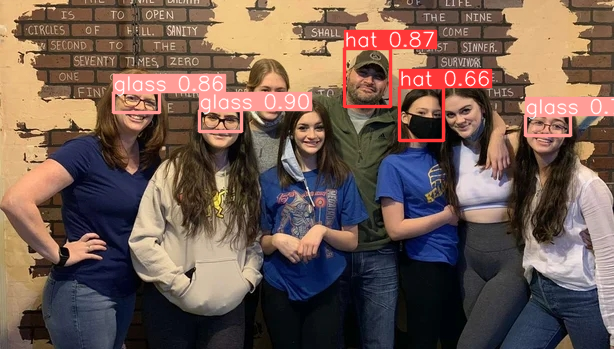

Prediction 2:


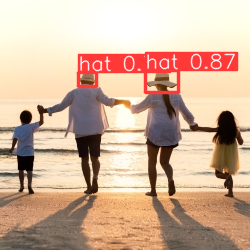

Prediction 3:


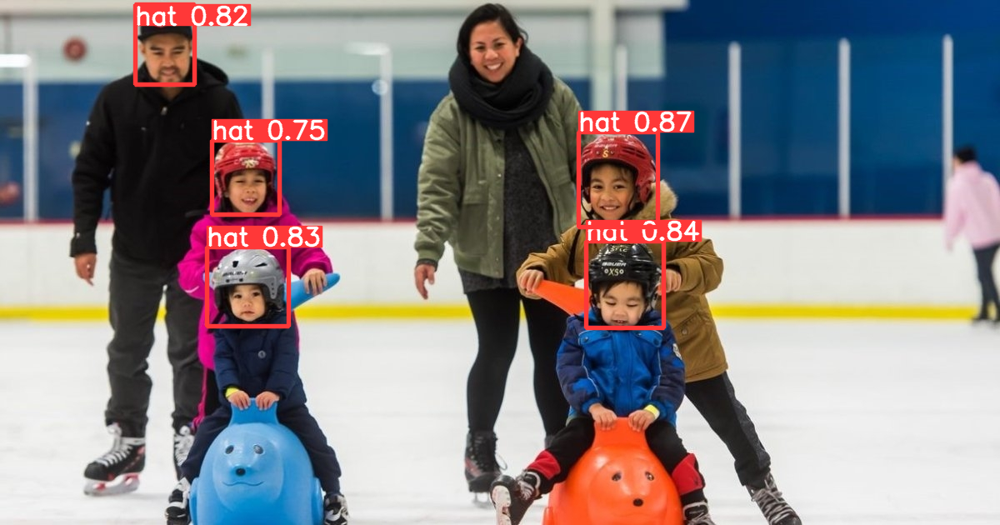

Prediction 4:


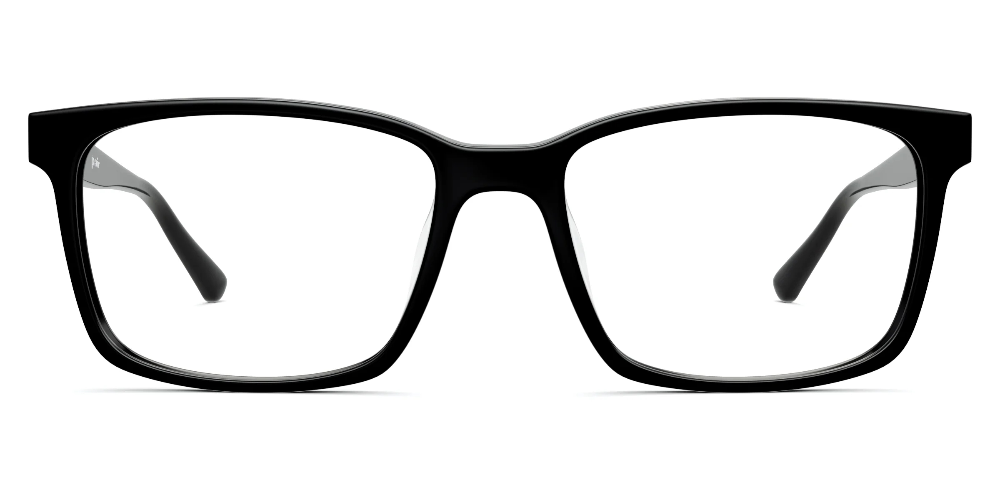

Prediction 5:


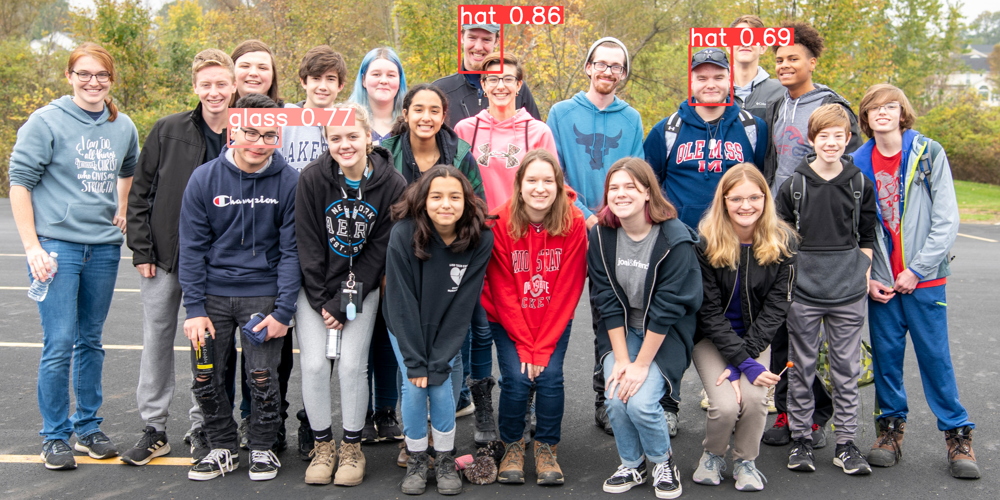

Prediction 6:


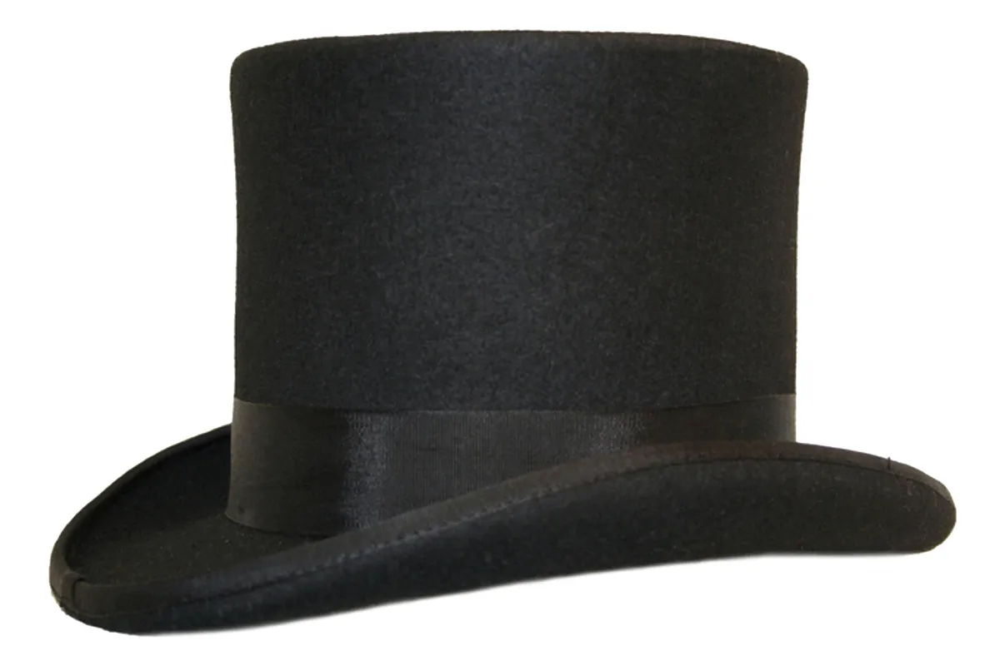

Prediction 7:


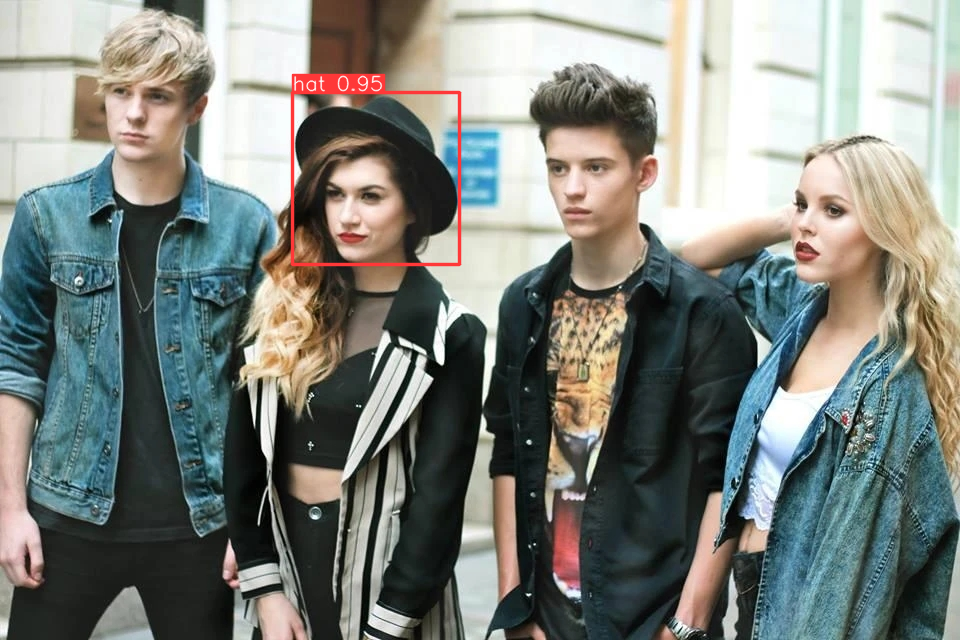

Prediction 8:


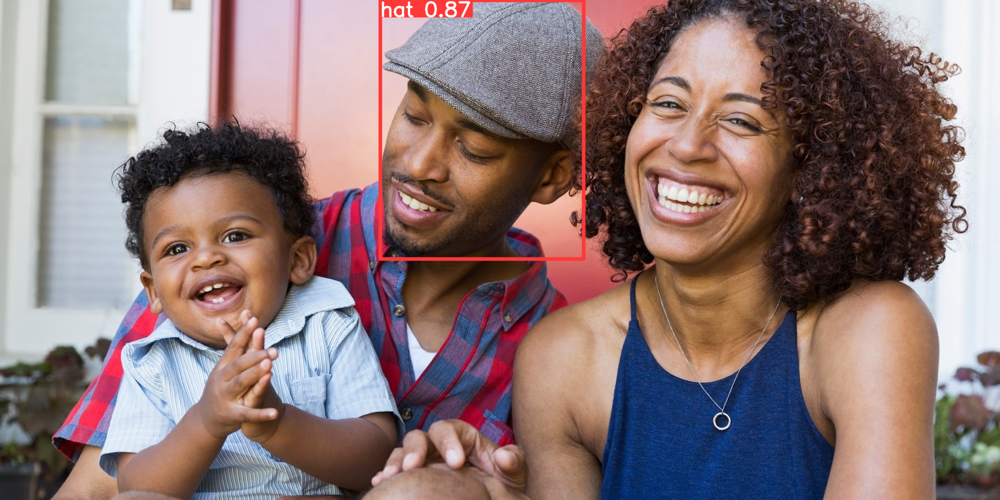

Prediction 9:


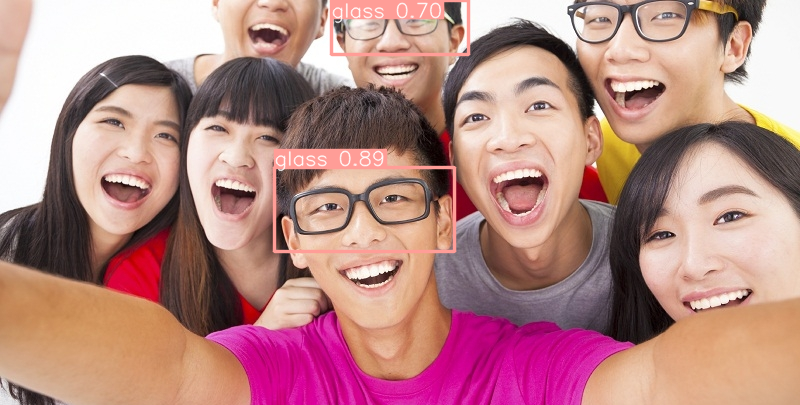

Prediction 10:


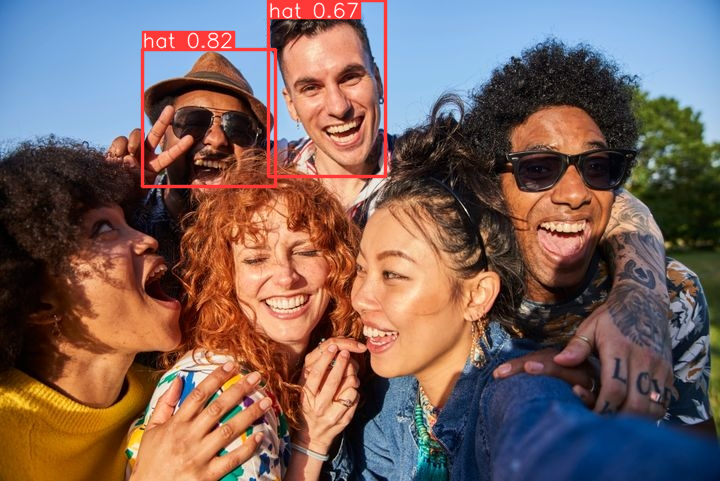

Prediction 11:


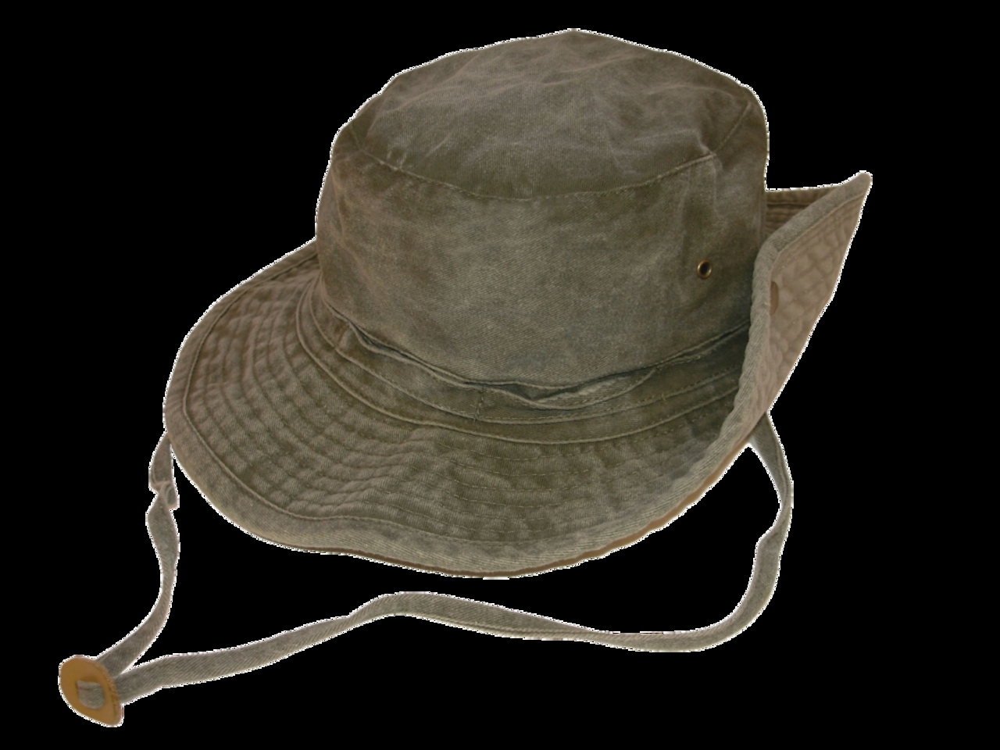

Prediction 12:


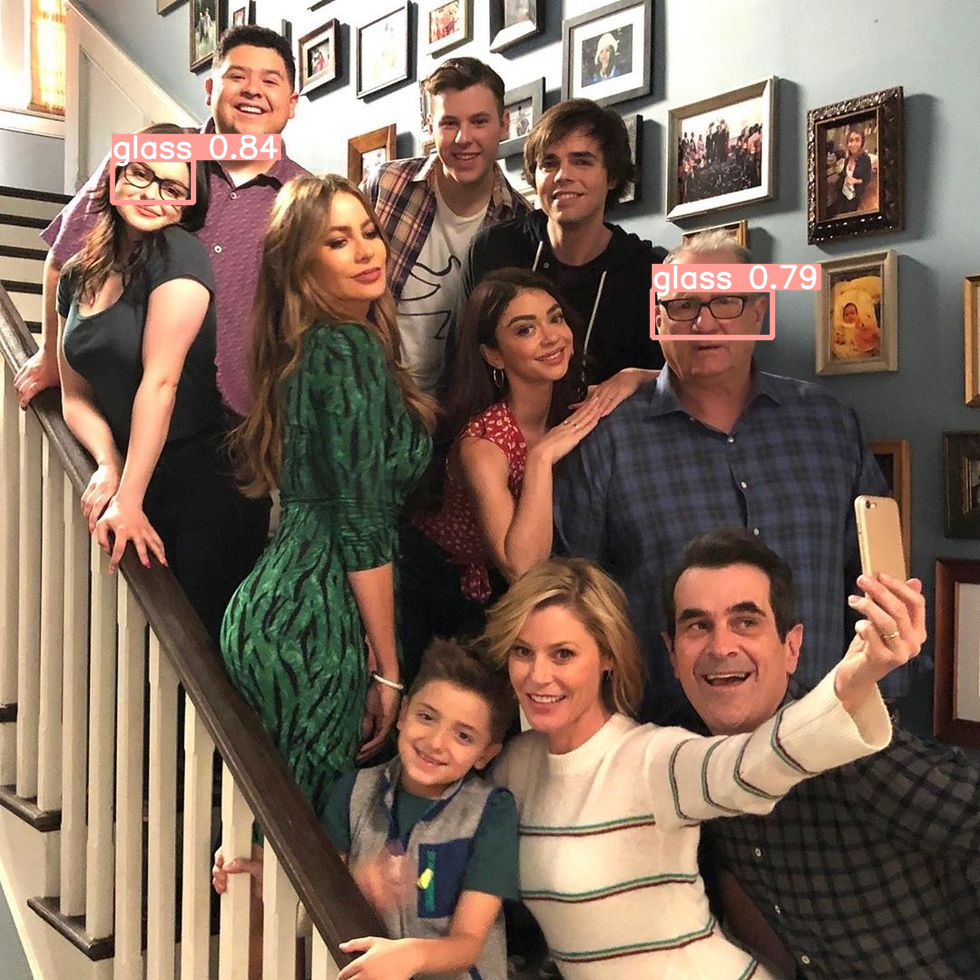

Prediction 13:


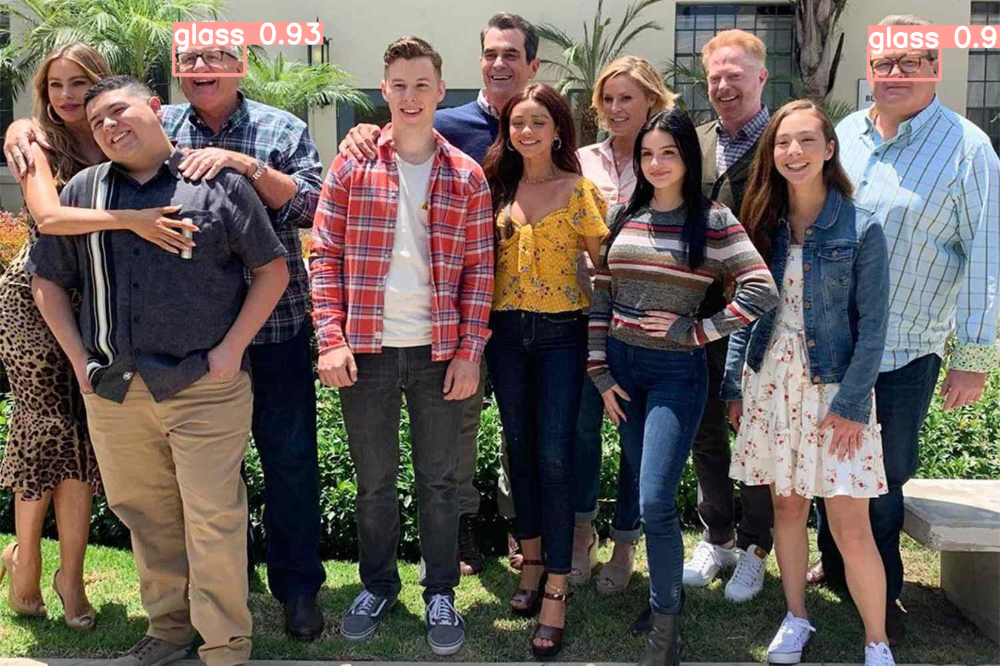

Prediction 14:


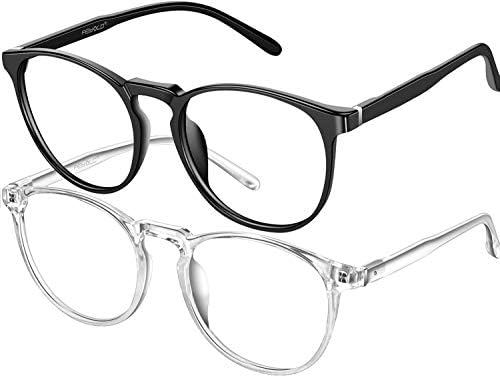

Prediction 15:


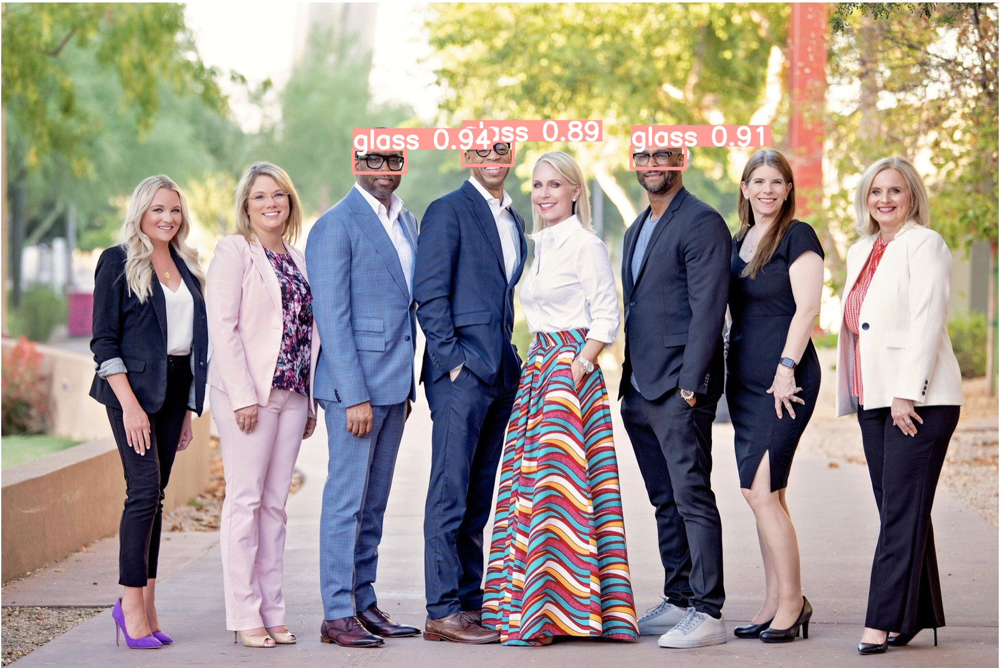

Prediction 16:


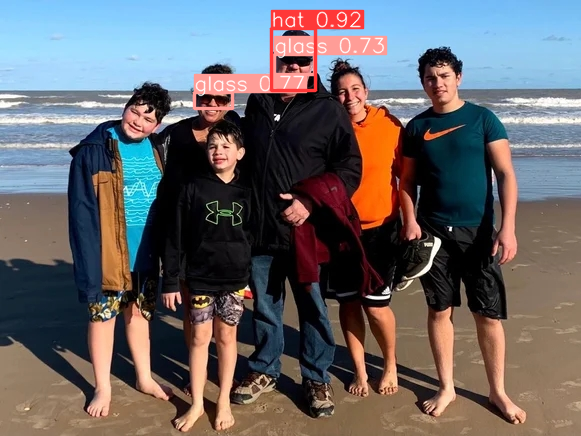

Prediction 17:


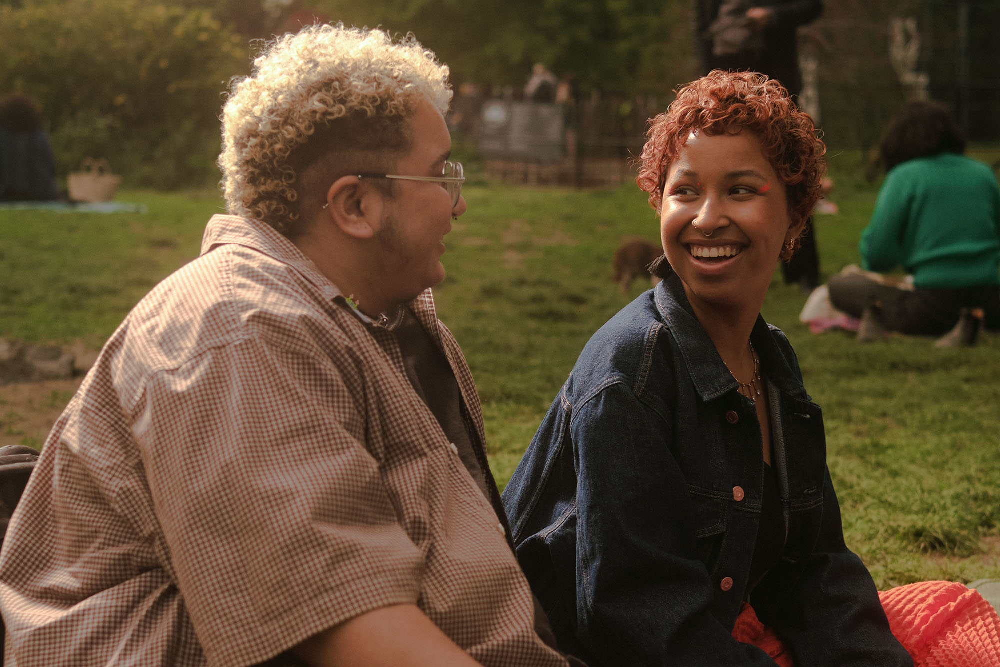

Results for image 2:
Prediction 1:


AttributeError: 'str' object has no attribute 'plot'

In [41]:
from PIL import Image
from IPython.display import display

# Visualize the results
for i, predictions in enumerate(results):
    print(f"Results for image {i + 1}:")
    for j, r in enumerate(predictions):
        print(f"Prediction {j + 1}:")
        # Plot results image
        im_bgr = r.plot()  # BGR-order numpy array
        im_rgb = Image.fromarray(im_bgr[..., ::-1])  # RGB-order PIL image
        
        # Display image in notebook
        display(im_rgb)

In [63]:
from detectron2.data import DatasetCatalog, MetadataCatalog
import os

def register_custom_dataset(name, image_root):
    DatasetCatalog.register(name, lambda: [(f, {}) for f in os.listdir(image_root) if f.endswith('.jpg')])
    MetadataCatalog.get(name).set(thing_classes=["your_class_1", "your_class_2", ...])  # Set your class names

In [65]:
# Unregister existing datasets if needed
if "my_dataset_train" in DatasetCatalog:
    DatasetCatalog.remove("my_dataset_train")
if "my_dataset_val" in DatasetCatalog:
    DatasetCatalog.remove("my_dataset_val")
if "my_dataset_test" in DatasetCatalog:
    DatasetCatalog.remove("my_dataset_test")

# Register datasets
register_custom_dataset("my_dataset_train", "C:/Users/shane/object-detect-main/data_models/images/train")
register_custom_dataset("my_dataset_val", "C:/Users/shane/object-detect-main/data_models/images/val")
register_custom_dataset("my_dataset_test", "C:/Users/shane/object-detect-main/data_models/images/test")

In [68]:
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.data.datasets import register_coco_instances
import os

# Check if the dataset is already registered
if "my_dataset_train" not in DatasetCatalog:
    # Register your dataset
    register_coco_instances("my_dataset_train", {}, "C:/Users/shane/object-detect-main/data_models/images/train/annotations.json", "C:/Users/shane/object-detect-main/data_models/images/train")
    register_coco_instances("my_dataset_val", {}, "C:/Users/shane/object-detect-main/data_models/images/val/annotations.json", "C:/Users/shane/object-detect-main/data_models/images/val")
    register_coco_instances("my_dataset_test", {}, "C:/Users/shane/object-detect-main/data_models/images/test/annotations.json", "C:/Users/shane/object-detect-main/data_models/images/test")
else:
    print("Dataset 'my_dataset_train' is already registered.")

Dataset 'my_dataset_train' is already registered.


In [71]:
from detectron2.model_zoo import model_zoo
# Create a configuration
cfg = get_cfg()
# Choose a model from Detectron2's model zoo
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set threshold for this model

In [73]:
cfg.MODEL.DEVICE = "cpu"
# Create a predictor
predictor = DefaultPredictor(cfg)

model_final_f10217.pkl: 178MB [00:04, 37.1MB/s]                              


In [74]:
# Get metadata for visualization
metadata = MetadataCatalog.get("my_dataset_train")

In [75]:
# Get dataset catalog
dataset_catalog = DatasetCatalog.get("my_dataset_train")

In [80]:
# Iterate over the images in the dataset
for dataset_info in dataset_catalog:
    print(dataset_info)

('hat_glasses_0.jpg', {})
('hat_glasses_1.jpg', {})
('hat_glasses_10.jpg', {})
('hat_glasses_100.jpg', {})
('hat_glasses_101.jpg', {})
('hat_glasses_102.jpg', {})
('hat_glasses_103.jpg', {})
('hat_glasses_104.jpg', {})
('hat_glasses_105.jpg', {})
('hat_glasses_106.jpg', {})
('hat_glasses_107.jpg', {})
('hat_glasses_108.jpg', {})
('hat_glasses_109.jpg', {})
('hat_glasses_11.jpg', {})
('hat_glasses_110.jpg', {})
('hat_glasses_111.jpg', {})
('hat_glasses_112.jpg', {})
('hat_glasses_113.jpg', {})
('hat_glasses_114.jpg', {})
('hat_glasses_115.jpg', {})
('hat_glasses_116.jpg', {})
('hat_glasses_117.jpg', {})
('hat_glasses_118.jpg', {})
('hat_glasses_119.jpg', {})
('hat_glasses_12.jpg', {})
('hat_glasses_120.jpg', {})
('hat_glasses_121.jpg', {})
('hat_glasses_122.jpg', {})
('hat_glasses_123.jpg', {})
('hat_glasses_124.jpg', {})
('hat_glasses_125.jpg', {})
('hat_glasses_126.jpg', {})
('hat_glasses_127.jpg', {})
('hat_glasses_128.jpg', {})
('hat_glasses_129.jpg', {})
('hat_glasses_13.jpg', {})


In [82]:
# Define the root directory of your dataset
dataset_root = "C:/Users/shane/object-detect-main/data_models/images/train"

# Iterate over the images in the dataset
for image_info in dataset_catalog:
    # Load an image
    img = cv2.imread(os.path.join(dataset_root, image_info[0]))  # image_info[0] contains the file name
    # Perform inference
    outputs = predictor(img)

    # Visualize the output
    v = Visualizer(img[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2.imshow('Mask R-CNN output', out.get_image()[:, :, ::-1])
    cv2.waitKey(0)
    cv2.destroyAllWindows()

KeyboardInterrupt: 

In [101]:
# Iterate over the selected images
for image_info in image_infos:
    # Load an image
    img = cv2.imread(os.path.join(dataset_root, image_info[0]))  # image_info[0] contains the file name
    
    # Perform inference
    outputs = predictor(img)

    # Visualize the output
    v = Visualizer(img[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    
    # Display the image with predictions
    cv2.imshow('Image with Mask R-CNN output', out.get_image()[:, :, ::-1])
    cv2.waitKey(0)
    cv2.destroyAllWindows()

KeyboardInterrupt: 

In [103]:
import matplotlib.pyplot as plt
# Visualize the results
for i, image_info in enumerate(dataset_catalog[:5]):  # Assuming you want to visualize the first 5 images
    # Load an image
    img = cv2.imread(os.path.join(dataset_root, image_info[0]))  # image_info[0] contains the file name
    
    # Perform inference
    outputs = predictor(img)
    
    # Convert image to RGB (since OpenCV loads images in BGR format)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # Create a visualizer
    visualizer = Visualizer(img_rgb, metadata=MetadataCatalog.get(cfg.DATASETS.TRAIN[0]))
    
    # Draw predictions on the image
    vis_output = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
    
    # Convert the visualized output image to RGB format
    vis_img_rgb = vis_output.get_image()
    
    # Display the visualized image
    plt.figure(figsize=(8, 8))
    plt.imshow(vis_img_rgb)
    plt.axis("off")
    plt.title(f"Prediction for Image {i+1}")
    plt.show()

<Figure size 800x800 with 1 Axes>

<Figure size 800x800 with 1 Axes>

<Figure size 800x800 with 1 Axes>

<Figure size 800x800 with 1 Axes>

<Figure size 800x800 with 1 Axes>

In [105]:
import matplotlib.pyplot as plt
from detectron2.utils.visualizer import Visualizer

# Iterate over the selected images
for image_info in image_infos[:5]:  # Display the first 5 images
    # Load an image
    img = cv2.imread(os.path.join(dataset_root, image_info[0]))  # image_info[0] contains the file name
    
    # Perform inference
    outputs = predictor(img)

    # Visualize the output
    v = Visualizer(img[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    
    # Display the image with predictions
    plt.figure(figsize=(8, 8))
    plt.imshow(out.get_image()[:, :, ::-1])
    plt.axis("off")
    plt.show()

<Figure size 800x800 with 1 Axes>

<Figure size 800x800 with 1 Axes>

<Figure size 800x800 with 1 Axes>

<Figure size 800x800 with 1 Axes>

<Figure size 800x800 with 1 Axes>

In [106]:
# Iterate over the selected images
for image_info in image_infos[:5]:  # Display the first 5 images
    # Load an image
    img = cv2.imread(os.path.join(dataset_root, image_info[0]))  # image_info[0] contains the file name
    
    # Perform inference
    outputs = predictor(img)

    # Visualize the output
    v = Visualizer(img[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    
    # Display the image with predictions
    cv2.imshow('Image with Mask R-CNN output', out.get_image()[:, :, ::-1])
    cv2.waitKey(0)
    cv2.destroyAllWindows()

KeyboardInterrupt: 

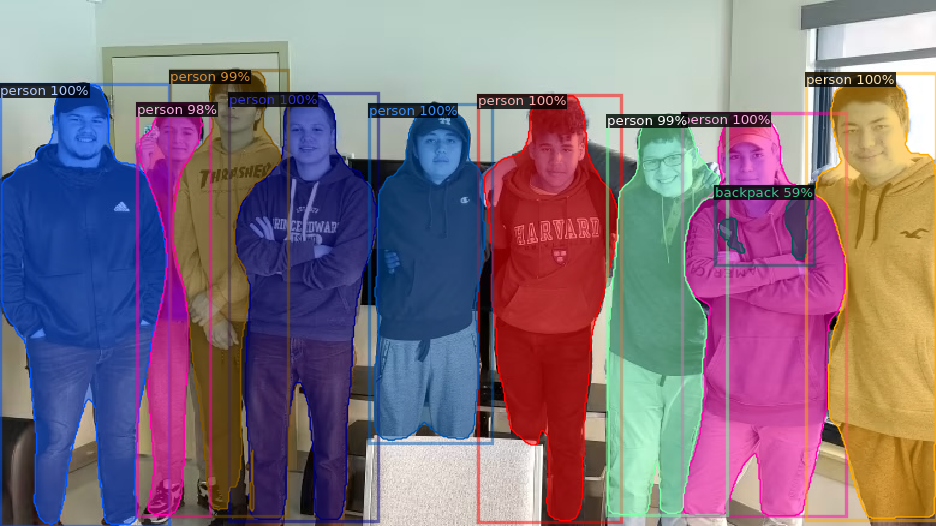

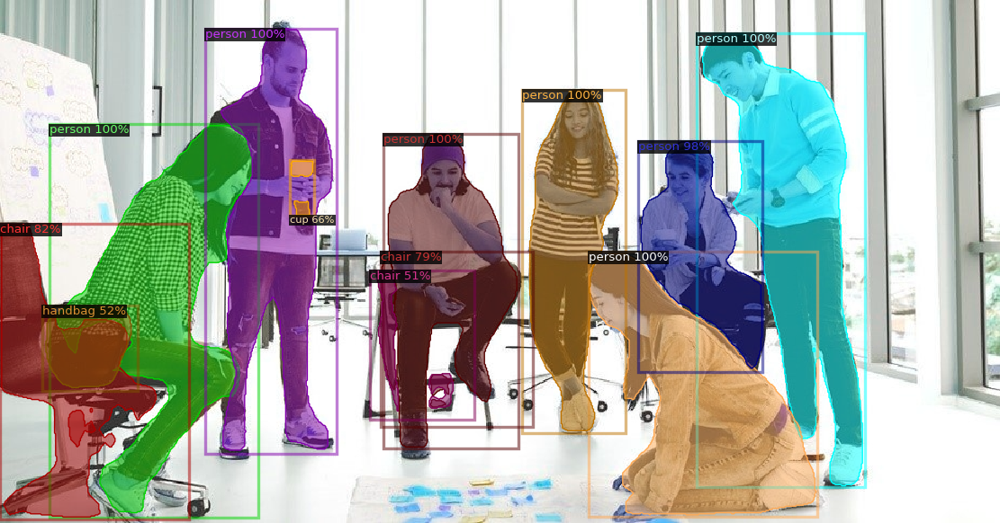

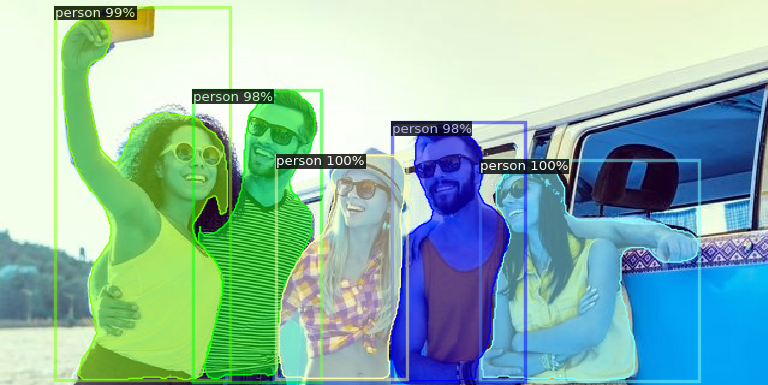

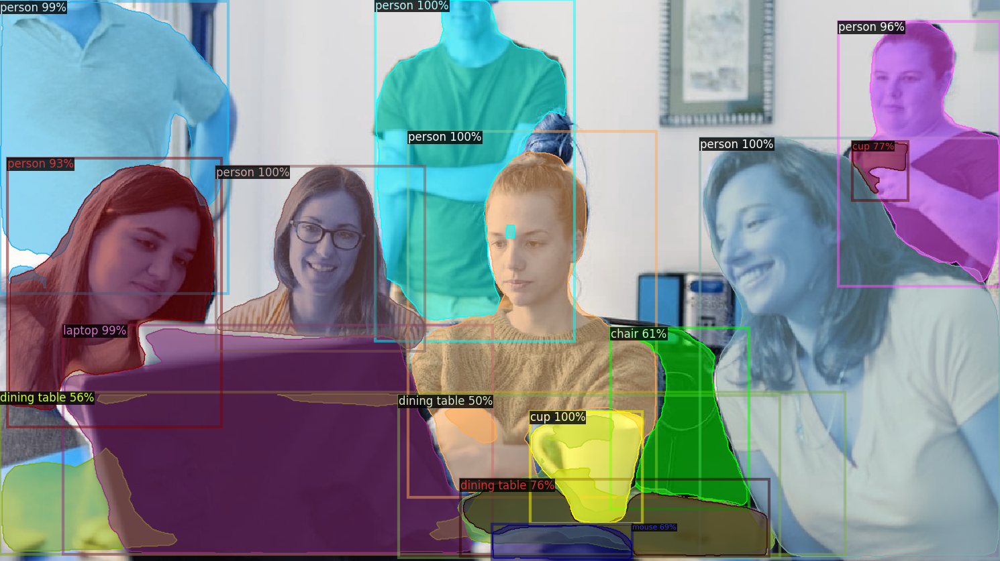

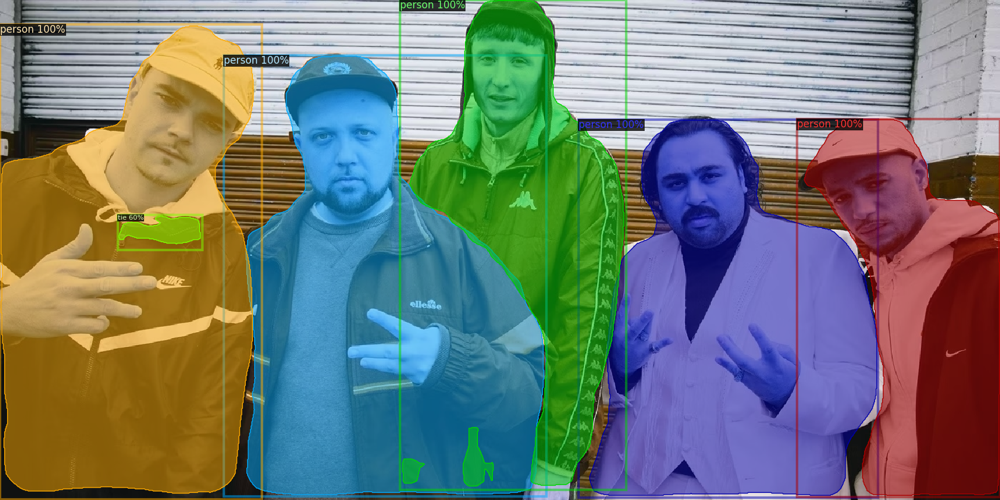

In [107]:
# Iterate over the selected images
for image_info in image_infos[:5]:  # Display the first 5 images
    # Load an image
    img = cv2.imread(os.path.join(dataset_root, image_info[0]))  # image_info[0] contains the file name
    
    # Perform inference
    outputs = predictor(img)

    # Visualize the output
    v = Visualizer(img[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    
    # Convert OpenCV image to PIL image
    pil_img = Image.fromarray(out.get_image()[:, :, ::-1])  # Convert BGR to RGB
    
    # Display the image with predictions in the notebook
    display(pil_img)